<a href="https://colab.research.google.com/github/shrestha1/AT3_MLA/blob/rusan/MLAA_AT3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Experiment Notebook**



## Context


### 0. Import Packages

In [ ]:
! pip install -r https://raw.githubusercontent.com/aso-uts/labs_datasets/main/36106-mlaa/requirements.txt

In [ ]:
import zipfile
import os
import gdown
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
import warnings

warnings.filterwarnings("ignore")

In [ ]:
from google.colab import drive

drive.mount('/content/gdrive')
%cd /content/gdrive/MyDrive

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
/content/gdrive/MyDrive


### 1.   Load Dataset

In [ ]:
# Extract ZIP file
def extract_file(zip_path, extract_to):
    if os.path.exists(zip_path):
        try:
            with zipfile.ZipFile(zip_path, 'r') as zip_ref:
                zip_ref.extractall(extract_to)
            print("Extraction was successful")
            os.remove(zip_path)
        except zipfile.BadZipFile:
            print("Failed to extract: the downloaded file is not a ZIP file or is corrupt")
    else:
        print("File does not exist, check the download URL and process.")

In [ ]:
# Link to dataset
url = 'https://drive.google.com/uc?id=1ipwbg0VClq9OGYP-B9wnFegKxPneMFug'
output_zip = '/content/bank_transaction.zip'

# Download the ZIP file
gdown.download(url, output_zip, quiet=False)

# Directory to extract the ZIP contents
extraction_directory = '/content/datasets/'

# Attempt to extract the ZIP file
extract_file(output_zip, extraction_directory)

Downloading...
From (original): https://drive.google.com/uc?id=1ipwbg0VClq9OGYP-B9wnFegKxPneMFug
From (redirected): https://drive.google.com/uc?id=1ipwbg0VClq9OGYP-B9wnFegKxPneMFug&confirm=t&uuid=37d8d778-64d9-42e2-9330-3aaeaca370b6
To: /content/bank_transaction.zip
100%|██████████| 215M/215M [00:01<00:00, 123MB/s]


Extraction was successful


In [ ]:
df= pd.read_csv('merged_data.csv')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
/content/gdrive/MyDrive


In [ ]:
csv_files = [f for f in os.listdir(f'{extraction_directory}final') if f.startswith('transactions_') and f.endswith('.csv')]
dataframes = [pd.read_csv(os.path.join(f'{extraction_directory}final', f), delimiter='|') for f in csv_files]

transactions_df = pd.concat(dataframes, ignore_index=True)

transactions_df.head()

,cc_num,acct_num,trans_num,unix_time,category,amt,is_fraud,merchant,merch_lat,merch_long
0,4909619797978,326474132970,2f300d84888d398856f18462ca81048d,1651329207,misc_pos,41.03,0,Torres-Davis,30.473613,-89.006731
1,4909619797978,326474132970,0d252e7c0b6274ce60c697780e10e93c,1652121210,misc_pos,66.17,0,Sanchez-Fuentes,29.034377,-89.356216
2,4909619797978,326474132970,69de7889eac55aa065a5f69eb5eb910d,1650120435,misc_net,65.99,0,"Cook, Gordon and Cameron",29.585810,-90.207869
3,4909619797978,326474132970,54bf046b1b57c1bb821625be5873d9f8,1650759278,misc_net,66.69,0,Hall Group,29.813094,-89.504049
4,4909619797978,326474132970,80ca47f8a6cf1c8e0efeeba1a0d18752,1643827462,grocery_net,80.73,0,Dickerson-Macdonald,29.732909,-90.873800


In [ ]:
transactions_df.shape

(4260904, 10)

In [ ]:
len(transactions_df.cc_num.unique())

983

In [ ]:
customer_df = pd.read_csv(f'{extraction_directory}final/customers.csv', delimiter='|')

In [ ]:
customer_df.head()

,ssn,cc_num,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob,acct_num
0,115-04-4507,4218196001337,Jonathan,Johnson,M,863 Lawrence Valleys,Ambler,PA,19002,40.1809,-75.2156,32412,Accounting technician,1959-10-03,888022315787
1,715-55-5575,4351161559407816183,Elaine,Fuller,F,310 Kendra Common Apt. 164,Leland,NC,28451,34.2680,-78.0578,27112,Professor Emeritus,1963-06-07,917558277935
2,167-48-5821,4192832764832,Michael,Cameron,M,05641 Robin Port,Cordova,SC,29039,33.4275,-80.8857,4215,International aid/development worker,1973-05-30,718172762479
3,406-83-7518,4238849696532874,Brandon,Williams,M,26916 Carlson Mountain,Birmingham,AL,35242,33.3813,-86.7046,493806,Seismic interpreter,1942-12-26,947268892251
4,697-93-1877,4514627048281480,Lisa,Hernandez,F,809 Burns Creek,Fargo,GA,31631,30.7166,-82.5801,559,Medical laboratory scientific officer,1939-05-22,888335239225


In [ ]:
len(customer_df.cc_num.unique())

1000

### 2. Explore Dataset

In [ ]:
df = pd.merge(transactions_df, customer_df, on=['cc_num', 'acct_num'])

In [ ]:
# from google.colab import drive

# drive.mount('/content/gdrive')
# %cd /content/gdrive/MyDrive

df.to_csv('merged_data.csv')
# df = pd.read_csv('merged_data.csv')

In [ ]:
pd.set_option('display.max_columns', None)
df.head()

,cc_num,acct_num,trans_num,unix_time,category,amt,is_fraud,merchant,merch_lat,merch_long,ssn,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob
0,4909619797978,326474132970,2f300d84888d398856f18462ca81048d,1651329207,misc_pos,41.03,0,Torres-Davis,30.473613,-89.006731,796-36-1134,Brandy,Nelson,F,413 Price Groves,New Orleans,LA,70131,29.9168,-89.996,382333,Secretary/administrator,1997-09-16
1,4909619797978,326474132970,0d252e7c0b6274ce60c697780e10e93c,1652121210,misc_pos,66.17,0,Sanchez-Fuentes,29.034377,-89.356216,796-36-1134,Brandy,Nelson,F,413 Price Groves,New Orleans,LA,70131,29.9168,-89.996,382333,Secretary/administrator,1997-09-16
2,4909619797978,326474132970,69de7889eac55aa065a5f69eb5eb910d,1650120435,misc_net,65.99,0,"Cook, Gordon and Cameron",29.585810,-90.207869,796-36-1134,Brandy,Nelson,F,413 Price Groves,New Orleans,LA,70131,29.9168,-89.996,382333,Secretary/administrator,1997-09-16
3,4909619797978,326474132970,54bf046b1b57c1bb821625be5873d9f8,1650759278,misc_net,66.69,0,Hall Group,29.813094,-89.504049,796-36-1134,Brandy,Nelson,F,413 Price Groves,New Orleans,LA,70131,29.9168,-89.996,382333,Secretary/administrator,1997-09-16
4,4909619797978,326474132970,80ca47f8a6cf1c8e0efeeba1a0d18752,1643827462,grocery_net,80.73,0,Dickerson-Macdonald,29.732909,-90.873800,796-36-1134,Brandy,Nelson,F,413 Price Groves,New Orleans,LA,70131,29.9168,-89.996,382333,Secretary/administrator,1997-09-16


In [ ]:
df.shape

(4260904, 23)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4260904 entries, 0 to 4260903
Data columns (total 23 columns):
 #   Column      Dtype  
---  ------      -----  
 0   cc_num      object 
 1   acct_num    object 
 2   trans_num   object 
 3   unix_time   object 
 4   category    object 
 5   amt         float64
 6   is_fraud    object 
 7   merchant    object 
 8   merch_lat   float64
 9   merch_long  float64
 10  ssn         object 
 11  first       object 
 12  last        object 
 13  gender      object 
 14  street      object 
 15  city        object 
 16  state       object 
 17  zip         int64  
 18  lat         float64
 19  long        float64
 20  city_pop    int64  
 21  job         object 
 22  dob         object 
dtypes: float64(5), int64(2), object(16)
memory usage: 747.7+ MB


In [ ]:
df.isnull().sum()

cc_num        0
acct_num      0
trans_num     0
unix_time     0
category      0
amt           0
is_fraud      0
merchant      0
merch_lat     0
merch_long    0
ssn           0
first         0
last          0
gender        0
street        0
city          0
state         0
zip           0
lat           0
long          0
city_pop      0
job           0
dob           0
dtype: int64

In [ ]:
df.describe()

,amt,merch_lat,merch_long,zip,lat,long,city_pop
count,4.260904e+06,4.260904e+06,4.260904e+06,4.260904e+06,4.260904e+06,4.260904e+06,4.260904e+06
mean,6.898790e+01,3.735276e+01,-9.247610e+01,5.190384e+04,3.735269e+01,-9.247593e+01,3.038011e+05
std,1.618467e+02,5.504630e+00,1.741603e+01,2.996720e+04,5.474364e+00,1.740613e+01,5.696231e+05
min,1.000000e+00,1.859001e+01,-1.603677e+02,1.571000e+03,1.958930e+01,-1.593683e+02,1.050000e+02
25%,9.100000e+00,3.370138e+01,-9.903072e+01,2.750500e+04,3.378360e+01,-9.868950e+01,2.010300e+04
50%,4.449000e+01,3.819365e+01,-8.727445e+01,4.920200e+04,3.824200e+01,-8.717940e+01,6.759300e+04
75%,8.158000e+01,4.120567e+01,-7.966098e+01,7.870400e+04,4.098200e+01,-7.994400e+01,2.420370e+05
max,4.130053e+04,6.577610e+01,-6.724632e+01,9.970500e+04,6.478050e+01,-6.824480e+01,2.906700e+06


### 3. Explore Target variable

### 4. Explore Variables of Interest

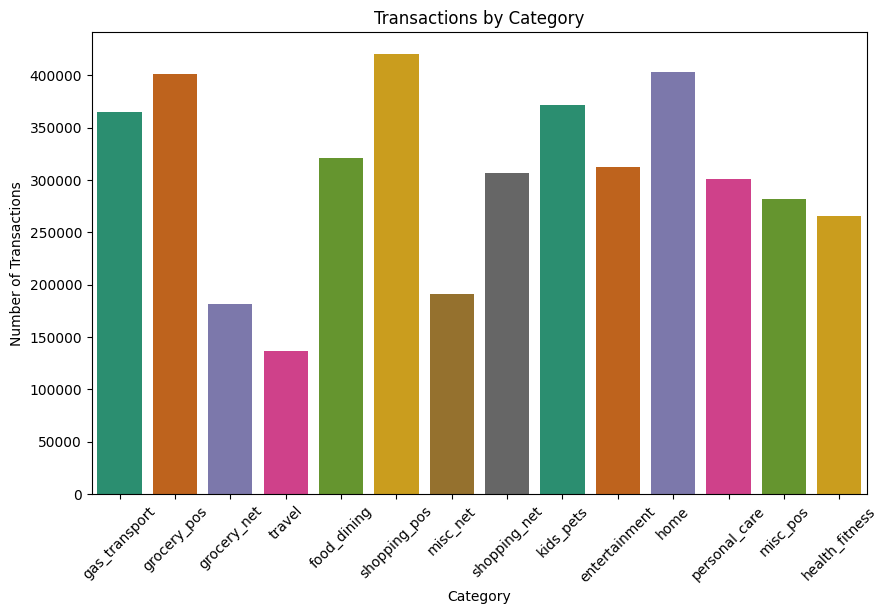

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(x=df.category, palette="Dark2")
plt.xticks(rotation=45)
plt.title('Transactions by Category')
plt.xlabel('Category')
plt.ylabel('Number of Transactions')
plt.show()

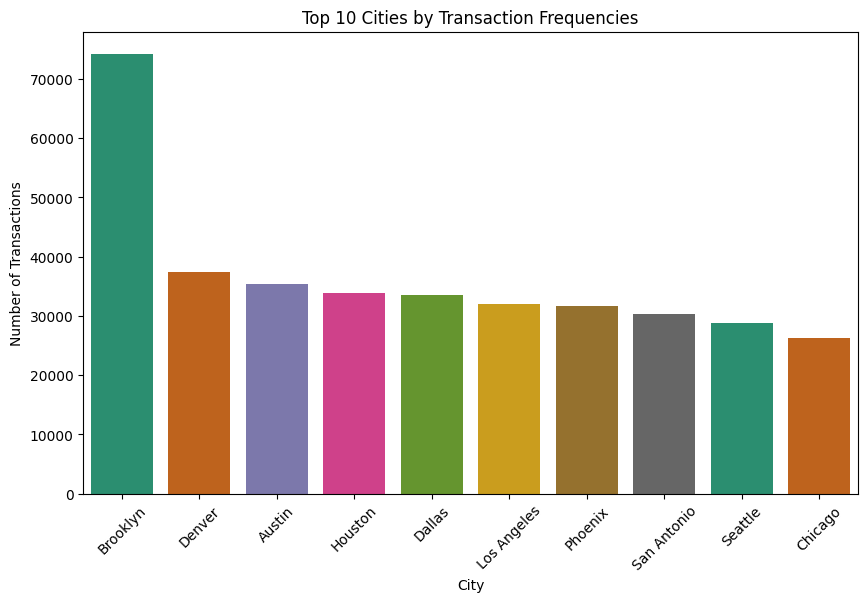

In [ ]:
# Get the top 10 cities by transaction frequency
city_transaction_counts = df['city'].value_counts().head(10)

# Plot the data
plt.figure(figsize=(10, 6))
sns.barplot(x=city_transaction_counts.index, y=city_transaction_counts.values, palette="Dark2")
plt.title('Top 10 Cities by Transaction Frequencies')
plt.xlabel('City')
plt.ylabel('Number of Transactions')
plt.xticks(rotation=45)
plt.show()

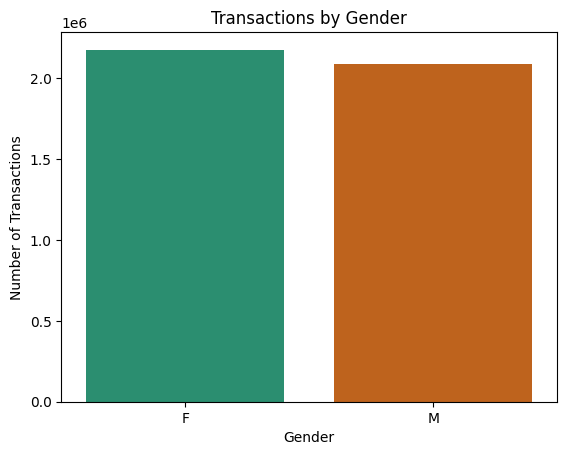

In [ ]:
gender_counts = df['gender'].value_counts()
sns.barplot(x=gender_counts.index, y=gender_counts.values,  palette="Dark2")
plt.title('Transactions by Gender')
plt.xlabel('Gender')
plt.ylabel('Number of Transactions')
plt.show()

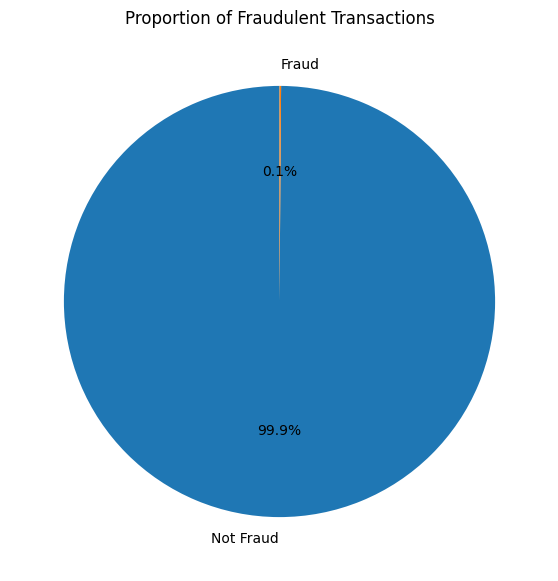

In [ ]:
fraud_counts = df['is_fraud'].value_counts()
plt.figure(figsize=(7, 7))
plt.pie(fraud_counts, labels=['Not Fraud', 'Fraud'], autopct='%1.1f%%', startangle=90)
plt.title('Proportion of Fraudulent Transactions')
plt.show()

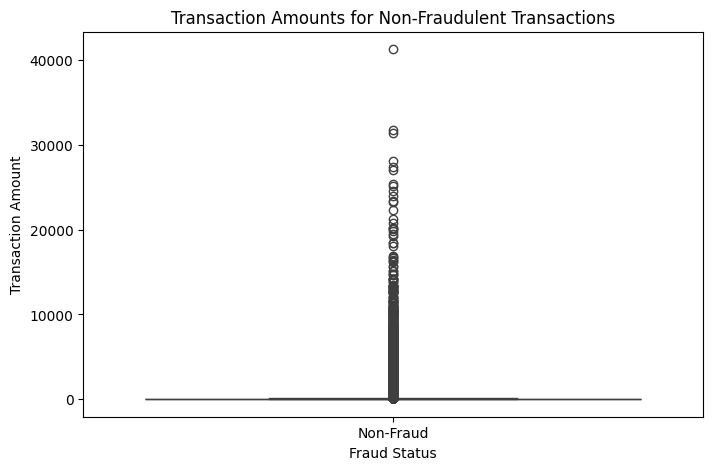

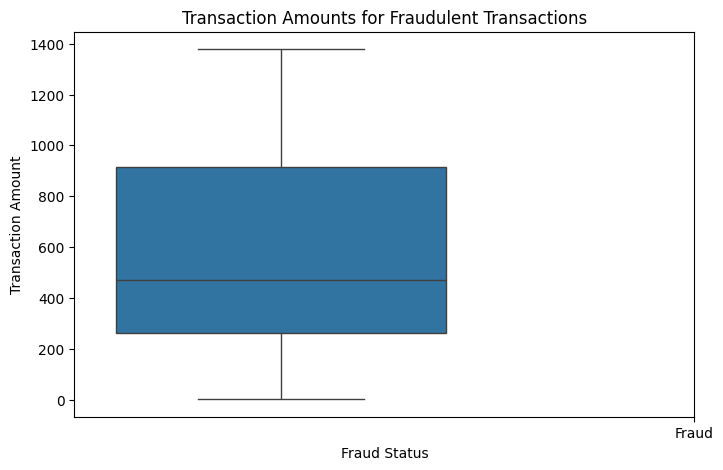

In [ ]:
# Plot the box plot for non-fraudulent transactions
plt.figure(figsize=(8, 5))
sns.boxplot(x='is_fraud', y='amt', data=df[df['is_fraud'] == 0])
plt.title('Transaction Amounts for Non-Fraudulent Transactions')
plt.xlabel('Fraud Status')
plt.ylabel('Transaction Amount')
plt.xticks([0], ['Non-Fraud'])
plt.show()

# Plot the box plot for fraudulent transactions
plt.figure(figsize=(8, 5))
sns.boxplot(x='is_fraud', y='amt', data=df[df['is_fraud'] == 1])
plt.title('Transaction Amounts for Fraudulent Transactions')
plt.xlabel('Fraud Status')
plt.ylabel('Transaction Amount')
plt.xticks([1], ['Fraud'])
plt.show()

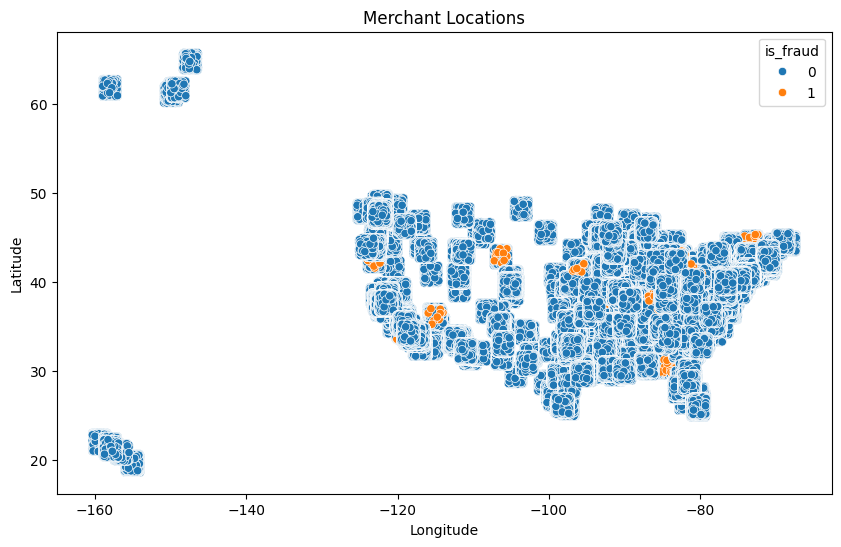

In [ ]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='merch_long', y='merch_lat', hue='is_fraud', data=df)
plt.title('Merchant Locations')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

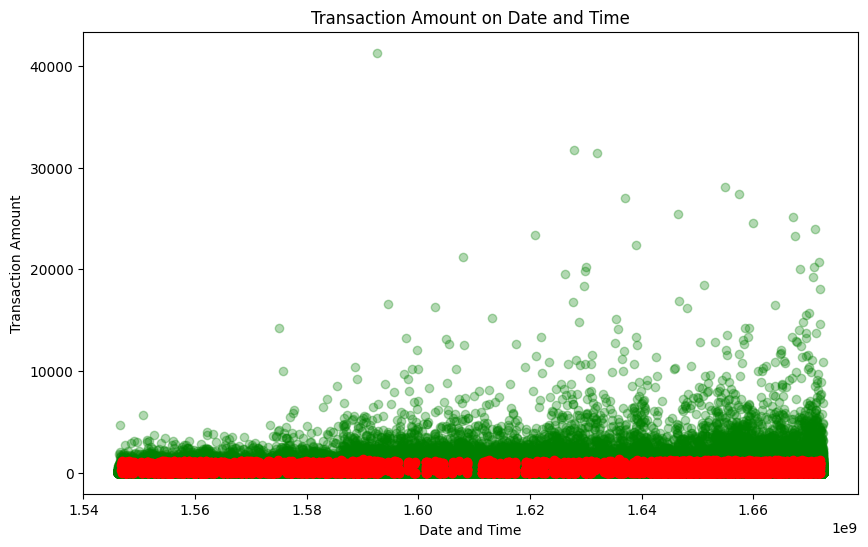

In [ ]:
plt.figure(figsize=(10, 6))
non_fraud = df[df['is_fraud'] == 0]
plt.scatter(non_fraud['unix_time'], non_fraud['amt'], color='green', alpha=0.3, label='Non-Fraudulent')

# Plot fraudulent transactions with darker color
fraud = df[df['is_fraud'] == 1]
plt.scatter(fraud['unix_time'], fraud['amt'], color='red', alpha=1.0, label='Fraudulent')

plt.title('Transaction Amount on Date and Time')
plt.xlabel('Date and Time')
plt.ylabel('Transaction Amount')
plt.legend()
plt.show()

In [ ]:
def calculate_age(df):
  x = pd.to_datetime(df['unix_time'], unit='s')
  y = pd.to_datetime(df['dob'])
  return x-y

In [ ]:
# Convert unix_time to datetime if it's in Unix format
df['unix_time'] = pd.to_datetime(df['unix_time'], unit='s')
df['dob'] = pd.to_datetime(df['dob'])

def calculate_age(row):
    return row['unix_time'] - row['dob']

# Apply the function to calculate age
df['age'] = df.apply(calculate_age, axis=1)

# Convert the age from timedelta to years
df['age'] = df['age'].apply(lambda x: x.days // 365)

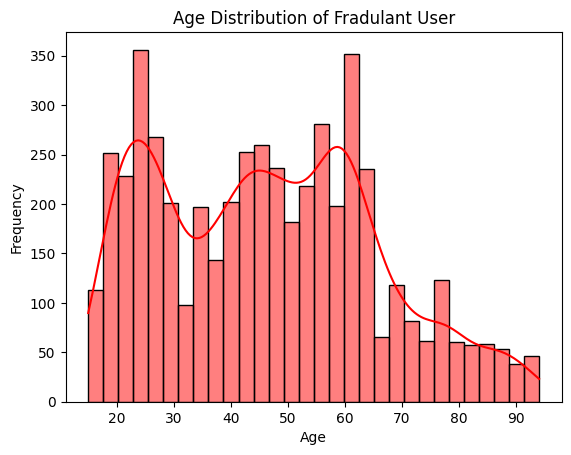

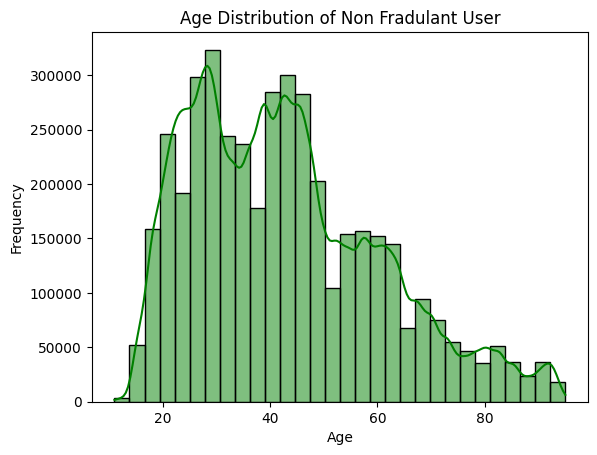

In [ ]:
# Plot the age distribution of the cardholders
sns.histplot(df['age'][df['is_fraud']==1], bins=30, kde=True, color='red')
plt.title('Age Distribution of Fradulant User')
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.show()

sns.histplot(df['age'][df['is_fraud']==0], bins=30, kde=True, color='green')
plt.title('Age Distribution of Non Fradulant User')
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.show()

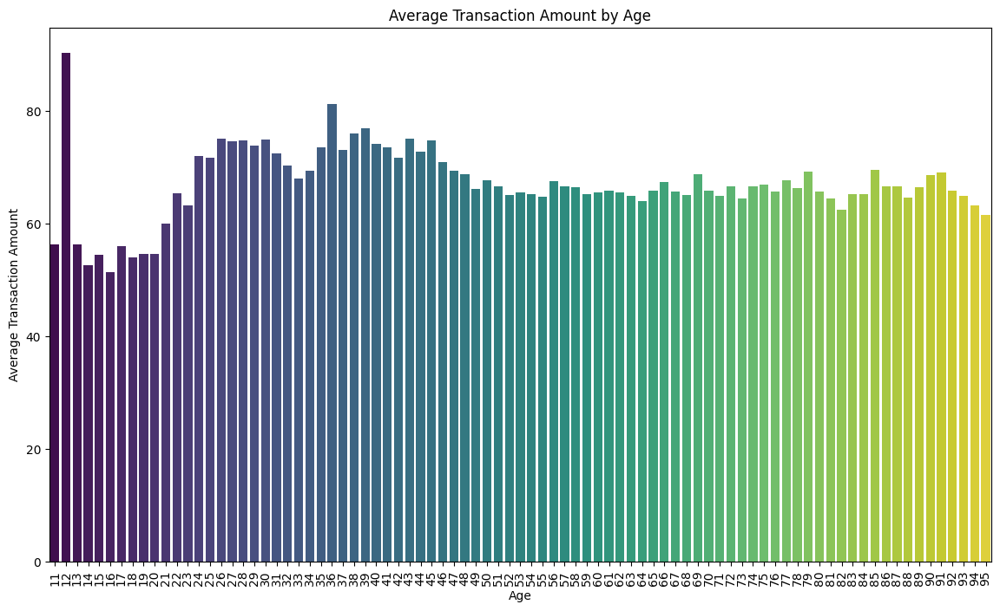

In [ ]:
# Calculate the average transaction amount by age
age_amt_mean = df.groupby('age')['amt'].mean().reset_index()

# Plot the average transaction amount by age
plt.figure(figsize=(14, 8))
sns.barplot(x='age', y='amt', data=age_amt_mean, palette="viridis")
plt.title('Average Transaction Amount by Age')
plt.xlabel('Age')
plt.ylabel('Average Transaction Amount')
plt.xticks(rotation=90)  # Rotate x-axis labels if necessary
plt.show()

In [ ]:
def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # Radius of the Earth in kilometers

    lat1_rad = np.radians(lat1)
    lon1_rad = np.radians(lon1)
    lat2_rad = np.radians(lat2)
    lon2_rad = np.radians(lon2)

    dlat = lat2_rad - lat1_rad
    dlon = lon2_rad - lon1_rad

    a = np.sin(dlat / 2) ** 2 + np.cos(lat1_rad) * np.cos(lat2_rad) * np.sin(dlon / 2) ** 2
    c = 2 * np.arcsin(np.sqrt(a))

    distance = R * c
    return distance

In [ ]:
df['distance_km'] = df.apply(lambda row: haversine(row['lat'], row['long'], row['merch_lat'], row['merch_long']), axis=1)

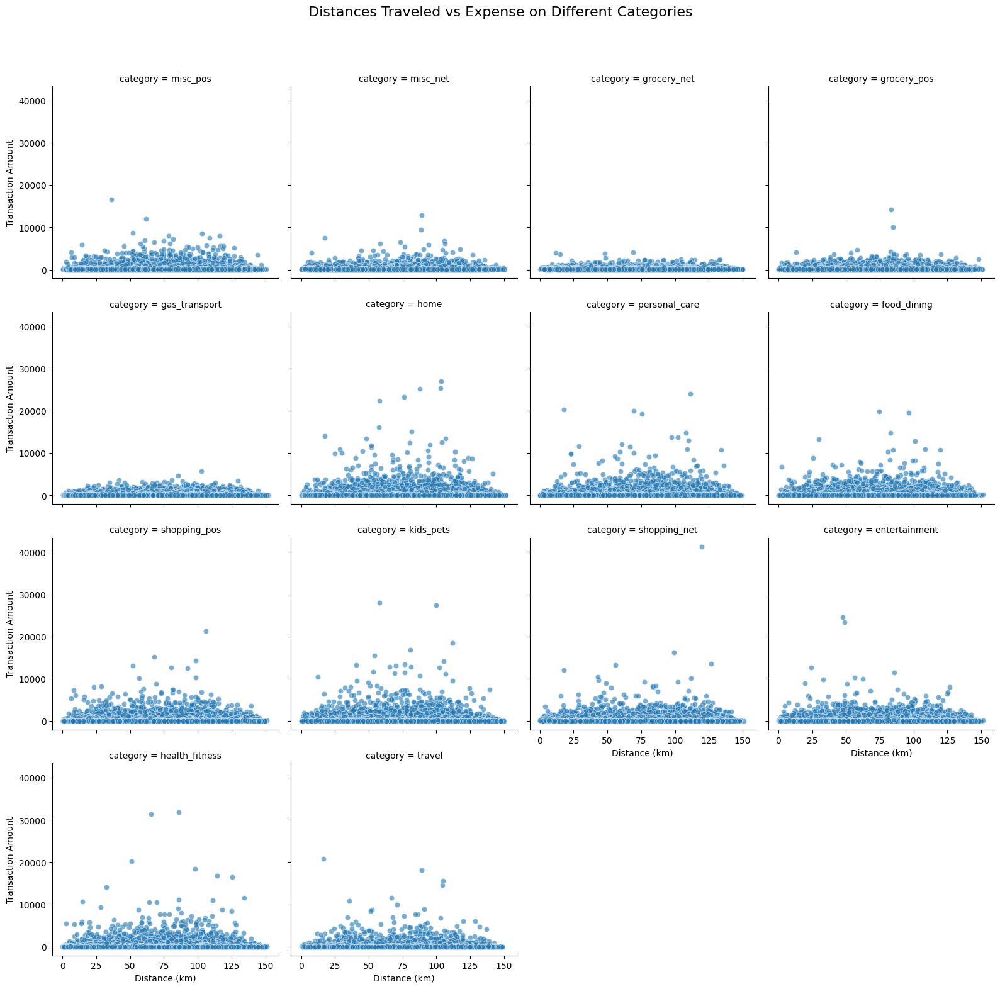

In [ ]:
g = sns.FacetGrid(df, col="category", col_wrap=4, height=4, sharex=True, sharey=True)
g.map(sns.scatterplot, 'distance_km', 'amt', alpha=0.6)

# Add titles and labels
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Distances Traveled vs Expense on Different Categories', fontsize=16)
g.set_axis_labels('Distance (km)', 'Transaction Amount')

# Show the plot
plt.show()

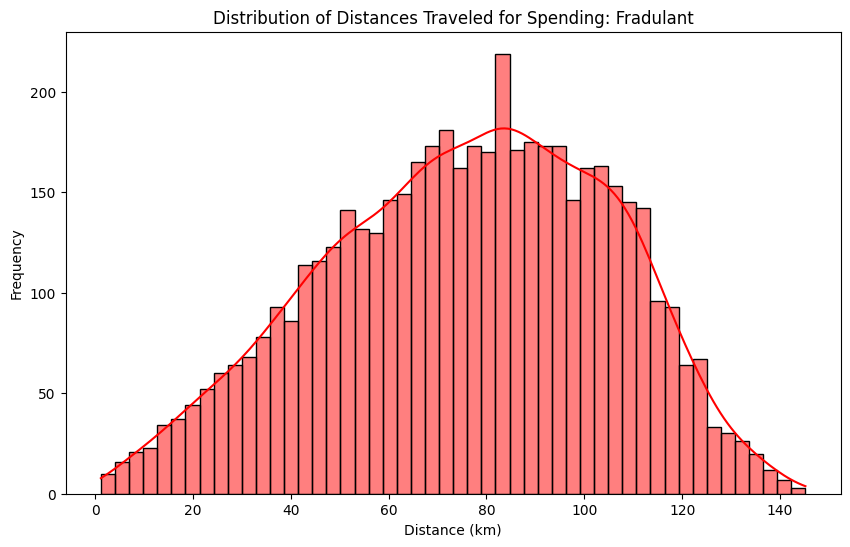

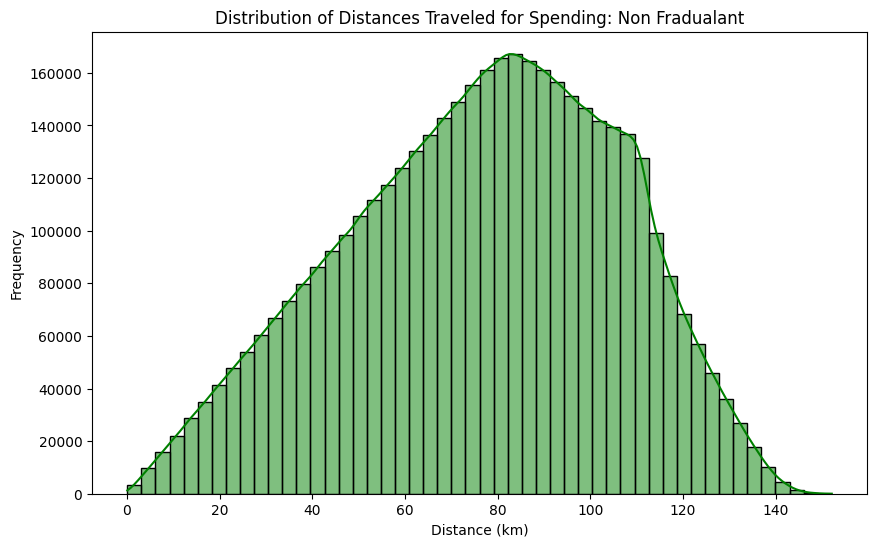

In [ ]:
# Plot the distribution of distances traveled
plt.figure(figsize=(10, 6))
sns.histplot(df[df['is_fraud']==1]['distance_km'], bins=50, kde=True, color='red')
plt.title('Distribution of Distances Traveled for Spending: Fradulant')
plt.xlabel('Distance (km)')
plt.ylabel('Frequency')
plt.show()

# Plot the distribution of distances traveled
plt.figure(figsize=(10, 6))
sns.histplot(df[df['is_fraud']==0]['distance_km'], bins=50, kde=True, color='green')
plt.title('Distribution of Distances Traveled for Spending: Non Fradualant')
plt.xlabel('Distance (km)')
plt.ylabel('Frequency')
plt.show()

In [ ]:
len(df.job.unique())

505

In [ ]:
txt = df['job'].to_string()

In [ ]:
from wordcloud import WordCloud

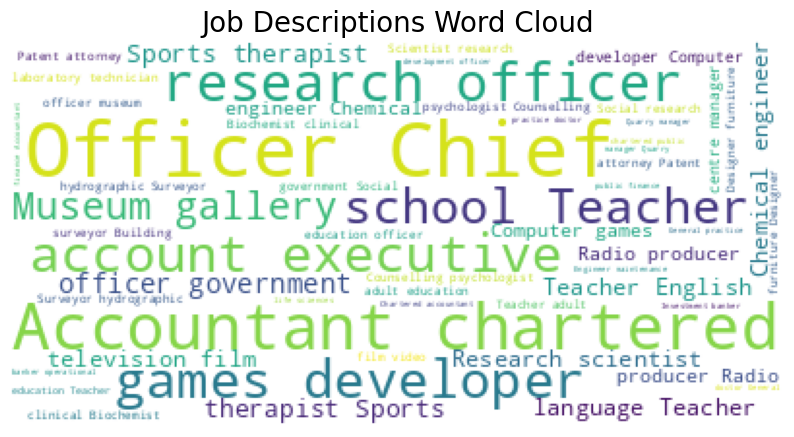

In [ ]:
# Create the word cloud
plt.figure(figsize=(10, 8))
wordcloud = WordCloud(max_words=400, background_color='white').generate(txt)
plt.imshow(wordcloud)
plt.title("Job Descriptions Word Cloud", fontsize=20)
plt.axis("off")
plt.show()

In [ ]:
# Define a mapping of job descriptions to broad categories
category_mapping = {
    'Teacher': ['teacher', 'tutor', 'educator', 'professor', 'instructor'],
    'Engineer': ['engineer', 'technician', 'architect', 'geologist', 'scientist'],
    'Manager': ['manager', 'administrator', 'director', 'supervisor'],
    'Medical Professional': ['doctor', 'nurse', 'therapist', 'pathologist', 'radiographer', 'psychologist', 'dentist', 'pharmacist', 'biochemist', 'cytogeneticist'],
    'Accountant': ['accountant', 'auditor', 'financial adviser', 'financial manager'],
    'Lawyer': ['solicitor', 'attorney', 'legal', 'barrister'],
    'Researcher': ['researcher', 'scientist'],
    'Sales': ['sales', 'account manager', 'sales executive'],
    'Media & Communications': ['editor', 'journalist', 'producer', 'broadcast', 'communications'],
    'IT Professional': ['software', 'developer', 'programmer', 'consultant', 'IT', 'data', 'analyst'],
    'Other': ['other']
}

# Function to categorize job descriptions
def categorize_job(description):
    description = description.lower()
    for category, keywords in category_mapping.items():
        if any(keyword in description for keyword in keywords):
            return category
    return 'Other'

# Improved function to handle overlaps
def improved_categorize_job(description):
    description = description.lower()
    category_scores = {category: 0 for category in category_mapping.keys()}

    for category, keywords in category_mapping.items():
        for keyword in keywords:
            if keyword in description:
                category_scores[category] += 1

    # Select category with the highest score
    best_category = max(category_scores, key=category_scores.get)
    return best_category

# Apply improved categorization function
df['job_desc'] = df['job'].apply(improved_categorize_job)

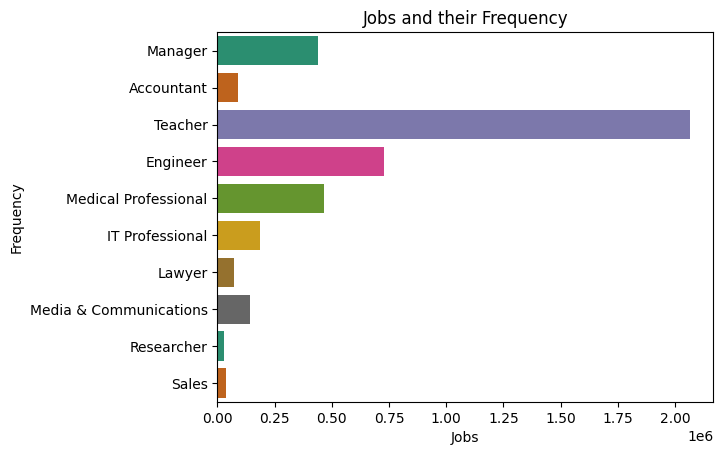

In [ ]:
sns.countplot(df['job_desc'],  palette="Dark2")
plt.title('Jobs and their Frequency')
plt.xlabel('Jobs')
plt.ylabel('Frequency')
plt.show()

In [ ]:
df.job_desc.unique()

array(['Manager', 'Accountant', 'Teacher', 'Engineer',
       'Medical Professional', 'IT Professional', 'Lawyer',
       'Media & Communications', 'Researcher', 'Sales'], dtype=object)

### 5. Prepare Data

In [ ]:
# df.to_csv('new_dataset.csv')

In [ ]:
df = pd.read_csv('new_dataset.csv')

In [ ]:
pd.set_option('display.max_columns', None)
df.head()

,Unnamed: 0,cc_num,acct_num,trans_num,unix_time,category,amt,is_fraud,merchant,merch_lat,merch_long,ssn,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob,age,distance_km,job_desc
0,0,4909619797978,326474132970,2f300d84888d398856f18462ca81048d,2022-04-30 14:33:27,misc_pos,41.03,0,Torres-Davis,30.473613,-89.006731,796-36-1134,Brandy,Nelson,F,413 Price Groves,New Orleans,LA,70131,29.9168,-89.996,382333,Secretary/administrator,1997-09-16,24,113.458127,Manager
1,1,4909619797978,326474132970,0d252e7c0b6274ce60c697780e10e93c,2022-05-09 18:33:30,misc_pos,66.17,0,Sanchez-Fuentes,29.034377,-89.356216,796-36-1134,Brandy,Nelson,F,413 Price Groves,New Orleans,LA,70131,29.9168,-89.996,382333,Secretary/administrator,1997-09-16,24,116.031115,Manager
2,2,4909619797978,326474132970,69de7889eac55aa065a5f69eb5eb910d,2022-04-16 14:47:15,misc_net,65.99,0,"Cook, Gordon and Cameron",29.585810,-90.207869,796-36-1134,Brandy,Nelson,F,413 Price Groves,New Orleans,LA,70131,29.9168,-89.996,382333,Secretary/administrator,1997-09-16,24,42.105872,Manager
3,3,4909619797978,326474132970,54bf046b1b57c1bb821625be5873d9f8,2022-04-24 00:14:38,misc_net,66.69,0,Hall Group,29.813094,-89.504049,796-36-1134,Brandy,Nelson,F,413 Price Groves,New Orleans,LA,70131,29.9168,-89.996,382333,Secretary/administrator,1997-09-16,24,48.819481,Manager
4,4,4909619797978,326474132970,80ca47f8a6cf1c8e0efeeba1a0d18752,2022-02-02 18:44:22,grocery_net,80.73,0,Dickerson-Macdonald,29.732909,-90.873800,796-36-1134,Brandy,Nelson,F,413 Price Groves,New Orleans,LA,70131,29.9168,-89.996,382333,Secretary/administrator,1997-09-16,24,87.112406,Manager


In [ ]:
df_cleaned = df.copy()

In [ ]:
def categorize_distance(distance):
    if distance <= 30:
        return 'Very Short Distance'
    elif distance <= 60:
        return 'Short Distance'
    elif distance <= 90:
        return 'Moderate Distance'
    elif distance <= 120:
        return 'Long Distance'
    else:
        return 'Very Long Distance'

# Apply categorization
df_cleaned['distance'] = df_cleaned['distance_km'].apply(categorize_distance)

In [ ]:
def categorize_age(age):
    if age <= 20:
        return '11-20'
    elif age <= 30:
        return '21-30'
    elif age <= 40:
        return '31-40'
    elif age <= 50:
        return '41-50'
    elif age <= 60:
        return '51-60'
    elif age <= 70:
        return '61-70'
    elif age <= 80:
        return '71-80'
    elif age <= 90:
        return '81-90'
    else:
        return '91+'

# Apply categorization
df_cleaned['age_category'] = df_cleaned['age'].apply(categorize_age)


In [ ]:
df.shape

(4260904, 27)

In [ ]:
data = pd.DataFrame()

In [ ]:
# First, group by the specified columns and sum the 'amt' values
grouped_data = df_cleaned.groupby(['city', 'state', 'job_desc', 'age_category', 'distance', 'category'])['amt'].sum().reset_index()

# Then, pivot the table so that each category value becomes a column
pivot_table = grouped_data.pivot_table(index=['city', 'state', 'job_desc', 'age_category', 'distance'],
                                       columns='category',
                                       values='amt',
                                       fill_value=0).reset_index()


In [ ]:
pivot_table

category,city,state,job_desc,age_category,distance,entertainment,food_dining,gas_transport,grocery_net,grocery_pos,health_fitness,home,kids_pets,misc_net,misc_pos,personal_care,shopping_net,shopping_pos,travel
0,Abbottstown,PA,Medical Professional,21-30,Long Distance,10117.78,9411.51,9094.37,16056.04,22502.97,12319.57,18540.93,12379.49,13326.13,12910.52,9308.94,8984.54,18950.22,687.28
1,Abbottstown,PA,Medical Professional,21-30,Moderate Distance,13864.75,13866.55,8374.89,12967.38,30065.98,10203.07,15673.86,13777.83,11050.25,20290.53,13509.64,19698.60,19008.20,1884.09
2,Abbottstown,PA,Medical Professional,21-30,Short Distance,5999.48,10654.46,6868.98,10126.65,17648.31,9197.97,10257.21,7398.97,7397.43,11629.76,9412.31,9756.31,11099.09,772.61
3,Abbottstown,PA,Medical Professional,21-30,Very Long Distance,1504.40,1225.15,1263.77,2353.88,3748.32,1993.22,2500.07,5140.84,1752.15,2646.95,1357.40,4217.13,2605.76,294.38
4,Abbottstown,PA,Medical Professional,21-30,Very Short Distance,2467.92,3184.05,1526.71,3468.83,6881.51,1109.39,2470.35,3876.71,2172.44,3057.63,3398.50,4281.31,2955.76,157.70
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6540,Zolfo Springs,FL,Medical Professional,81-90,Long Distance,560.73,404.87,837.58,79.58,732.35,337.58,807.58,485.32,3293.06,572.80,904.88,3459.94,753.10,345.40
6541,Zolfo Springs,FL,Medical Professional,81-90,Moderate Distance,206.88,582.38,600.74,29.18,262.89,109.91,820.51,1128.28,79.65,563.87,362.34,138.57,1090.26,238.23
6542,Zolfo Springs,FL,Medical Professional,81-90,Short Distance,260.52,227.73,637.97,6.57,140.75,100.44,380.90,274.39,166.89,307.99,256.53,331.92,152.97,0.00
6543,Zolfo Springs,FL,Medical Professional,81-90,Very Long Distance,91.66,129.39,97.19,0.00,421.06,42.62,182.43,89.28,0.00,47.84,117.13,3.80,131.52,0.00


In [ ]:
X = pivot_table.drop(['city', 'state', 'job_desc', 'age_category', 'distance'], axis=1)

In [ ]:
X.duplicated().sum()

0

In [ ]:
pivot_table['job_desc'].unique()

array(['Medical Professional', 'Engineer', 'Media & Communications',
       'Teacher', 'Manager', 'IT Professional', 'Accountant', 'Lawyer',
       'Researcher', 'Sales'], dtype=object)

### 6. Split Dataset

In [ ]:
X_train =
X_val =
X_test =

y_train =
y_val =
y_test =

SyntaxError: invalid syntax (<ipython-input-29-94f315717084>, line 1)

### 7. Baseline Model

In [ ]:
y_central =

In [ ]:
train_perf =
valid_perf =
test_perf =

### 8. Train Machine Learning Model

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
cluster_df = pd.DataFrame()
inertia_list = []

In [ ]:
# Solution
cluster_df['nb_cluster'] = range(1, 21)
cluster_df

,nb_cluster
0,1
1,2
2,3
3,4
4,5
5,6
6,7
7,8
8,9
9,10


In [ ]:
for k in cluster_df['nb_cluster']:
    kmeans = KMeans(n_clusters=k, random_state=8).fit(X)
    inertia_list.append(kmeans.inertia_)

In [ ]:
cluster_df['inertia'] = inertia_list

In [ ]:
cluster_df

,nb_cluster,inertia
0,1,1.837451e+12
1,2,9.029165e+11
2,3,6.383455e+11
3,4,5.462822e+11
4,5,4.988460e+11
5,6,4.582549e+11
6,7,4.318030e+11
7,8,4.088011e+11
8,9,3.886610e+11
9,10,3.705553e+11


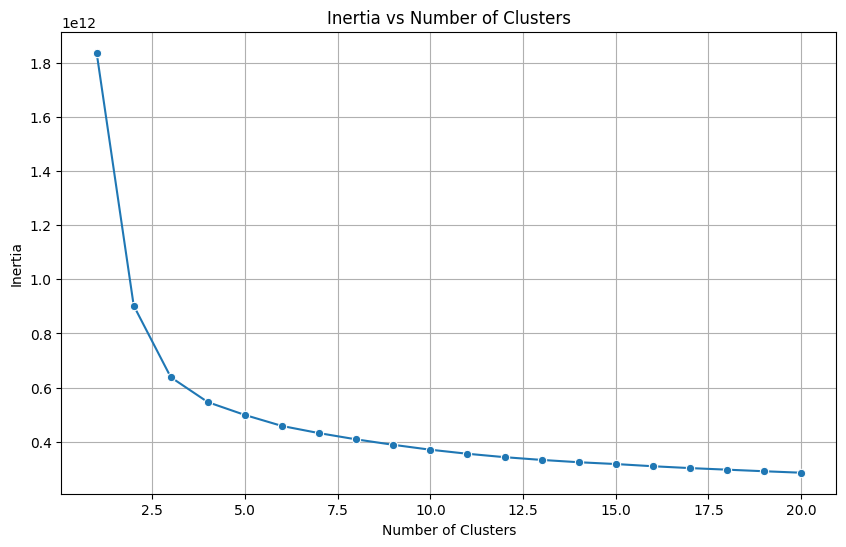

In [ ]:
plt.figure(figsize=(10, 6))
sns.lineplot(x='nb_cluster', y='inertia', data=cluster_df, marker='o')
plt.title('Inertia vs Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.grid(True)
plt.show()

In [ ]:
k = 3

In [ ]:
kmeans = KMeans(random_state=1, n_clusters=k)

In [ ]:
kmeans.fit(X)

KMeans(n_clusters=3, random_state=1)

In [ ]:
df_cleaned['kmeans'] = kmeans.predict(X)

In [ ]:
df_cleaned

category,entertainment,food_dining,gas_transport,grocery_net,grocery_pos,health_fitness,home,kids_pets,misc_net,misc_pos,personal_care,shopping_net,shopping_pos,travel,kmeans
0,10117.78,9411.51,9094.37,16056.04,22502.97,12319.57,18540.93,12379.49,13326.13,12910.52,9308.94,8984.54,18950.22,687.28,1
1,13864.75,13866.55,8374.89,12967.38,30065.98,10203.07,15673.86,13777.83,11050.25,20290.53,13509.64,19698.60,19008.20,1884.09,1
2,5999.48,10654.46,6868.98,10126.65,17648.31,9197.97,10257.21,7398.97,7397.43,11629.76,9412.31,9756.31,11099.09,772.61,2
3,1504.40,1225.15,1263.77,2353.88,3748.32,1993.22,2500.07,5140.84,1752.15,2646.95,1357.40,4217.13,2605.76,294.38,0
4,2467.92,3184.05,1526.71,3468.83,6881.51,1109.39,2470.35,3876.71,2172.44,3057.63,3398.50,4281.31,2955.76,157.70,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6540,560.73,404.87,837.58,79.58,732.35,337.58,807.58,485.32,3293.06,572.80,904.88,3459.94,753.10,345.40,0
6541,206.88,582.38,600.74,29.18,262.89,109.91,820.51,1128.28,79.65,563.87,362.34,138.57,1090.26,238.23,0
6542,260.52,227.73,637.97,6.57,140.75,100.44,380.90,274.39,166.89,307.99,256.53,331.92,152.97,0.00,0
6543,91.66,129.39,97.19,0.00,421.06,42.62,182.43,89.28,0.00,47.84,117.13,3.80,131.52,0.00,0


In [ ]:
columns = X.columns

In [ ]:
columns

Index(['entertainment', 'food_dining', 'gas_transport', 'grocery_net',
       'grocery_pos', 'health_fitness', 'home', 'kids_pets', 'misc_net',
       'misc_pos', 'personal_care', 'shopping_net', 'shopping_pos', 'travel'],
      dtype='object', name='category')

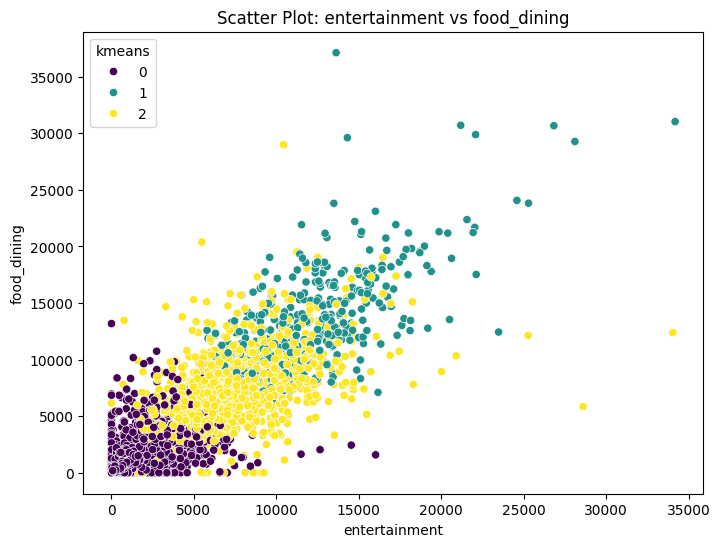

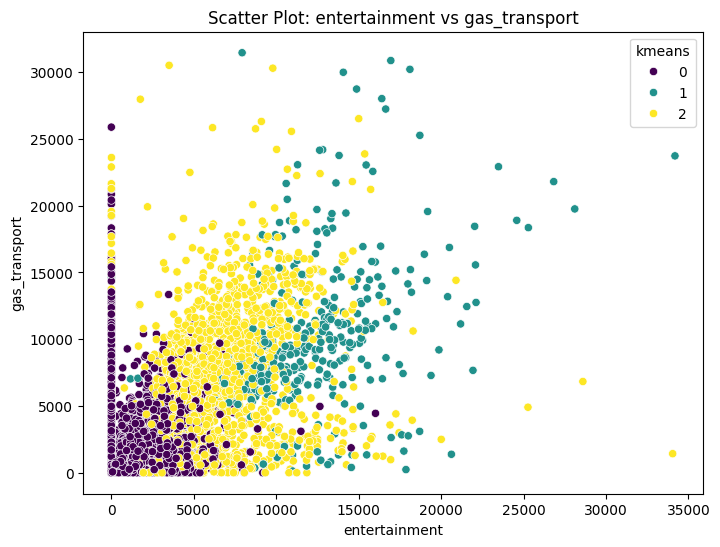

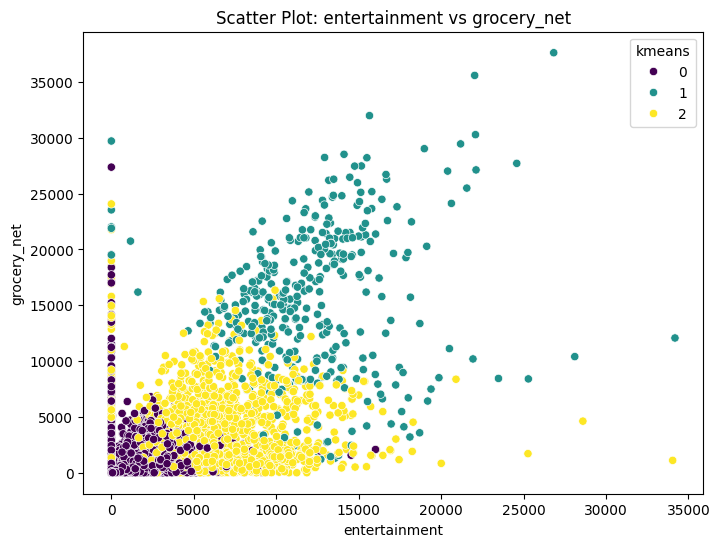

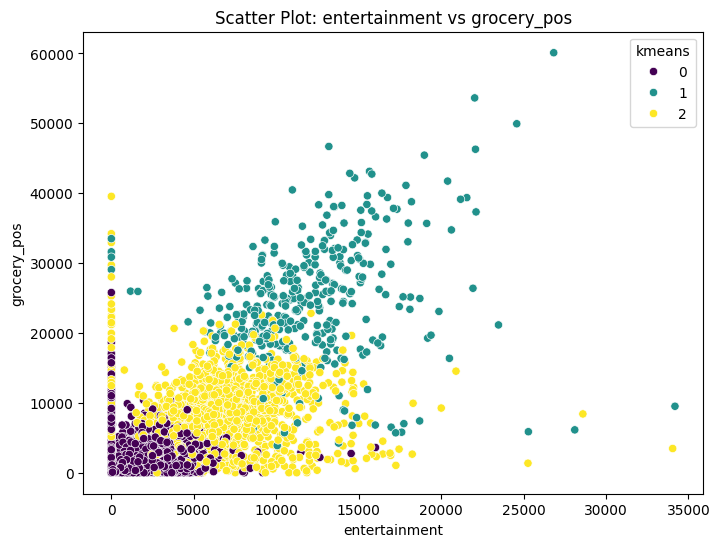

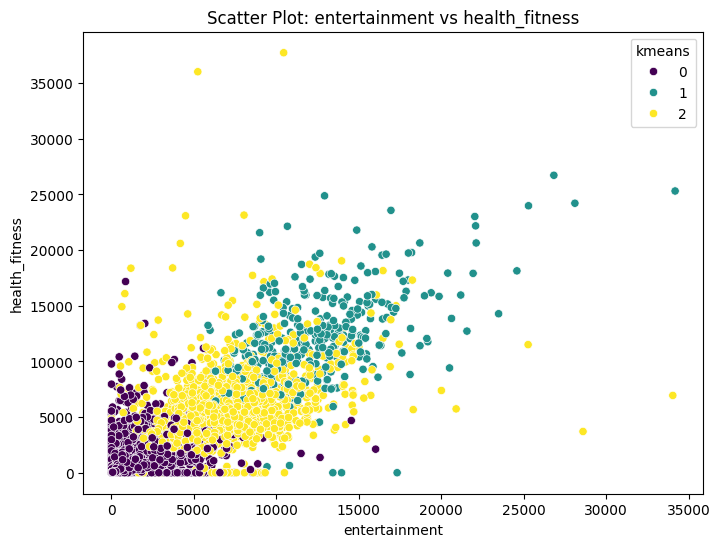

...

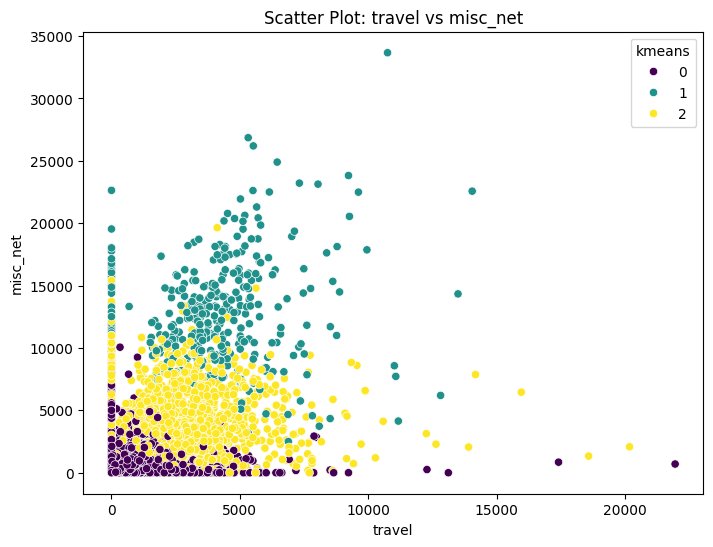

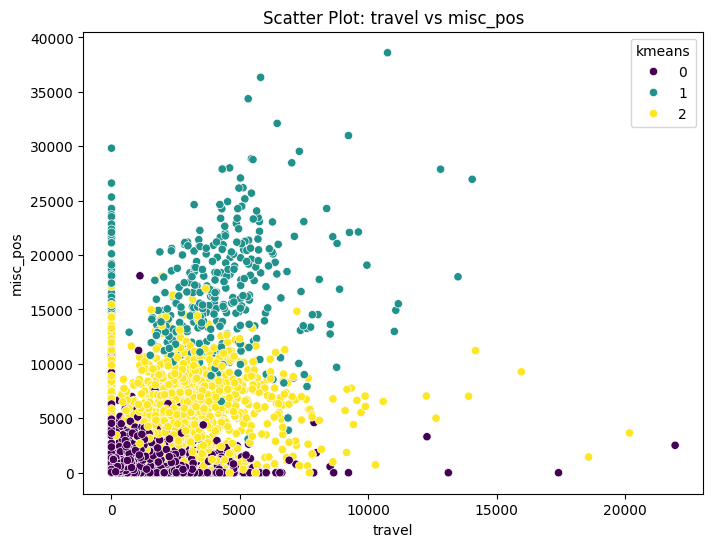

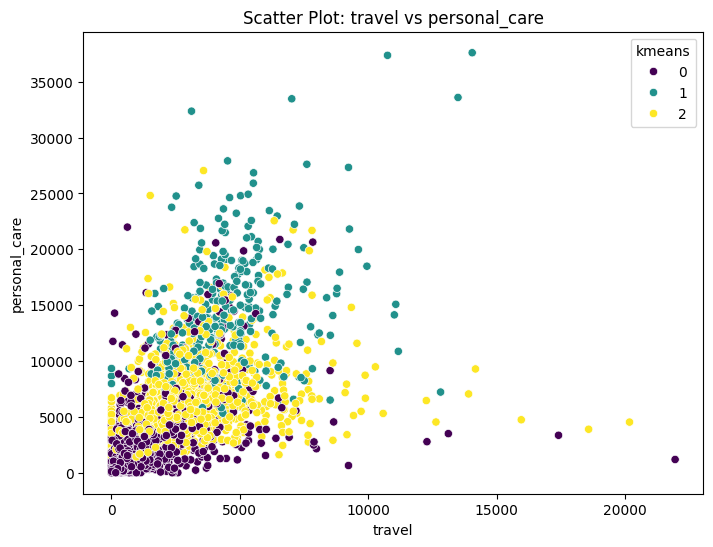

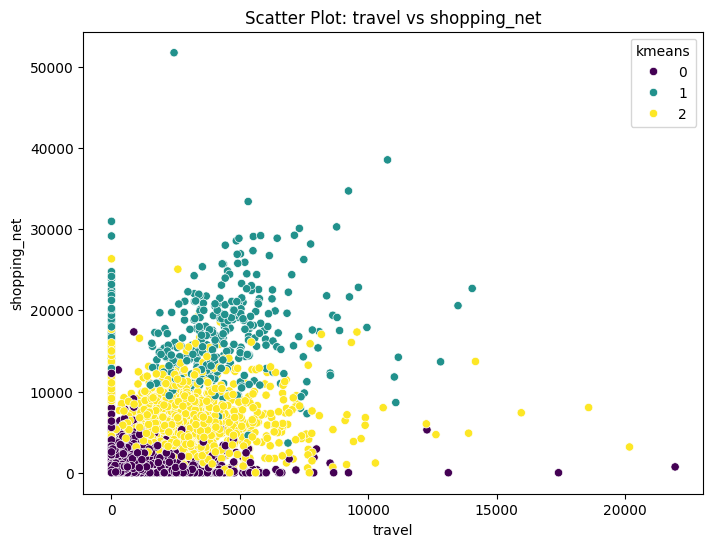

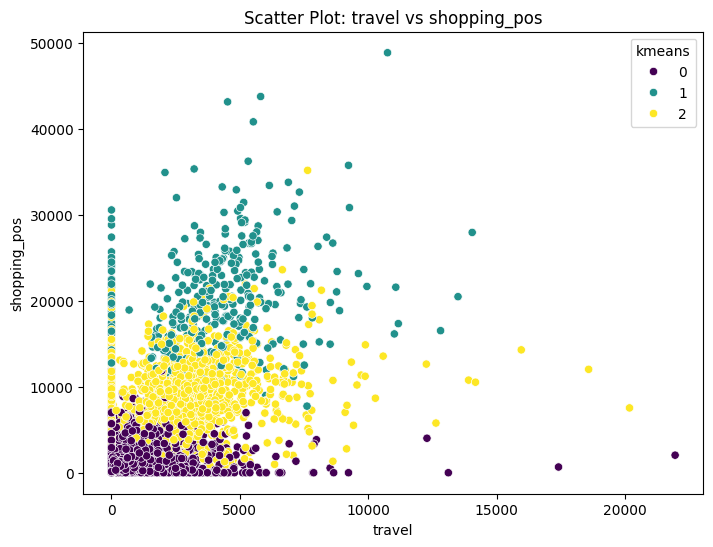

In [ ]:
# Create subplots grid
num_cols = len(columns)

for i, a in enumerate(columns):
  for j, b in enumerate(columns):
    if i != j:
      plt.figure(figsize=(8, 6))
      sns.scatterplot(x=a, y=b, hue='kmeans', data=df_cleaned, palette='viridis')
      plt.title(f'Scatter Plot: {a} vs {b}')
      plt.show()

### 9. Assess Model Performance

In [ ]:
model_train_perf =
model_valid_perf =
model_test_perf =